In [ ]:
# libraries installed to convert pdfs to images
!apt-get install poppler-utils
!pip install pdf2image

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upgraded, 1 newly installed, 0 to remove and 45 not upgraded.
Need to get 186 kB of archives.
After this operation, 696 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 poppler-utils amd64 22.02.0-2ubuntu0.4 [186 kB]
Fetched 186 kB in 1s (303 kB/s)
Selecting previously unselected package poppler-utils.
(Reading database ... 121913 files and directories currently installed.)
Preparing to unpack .../poppler-utils_22.02.0-2ubuntu0.4_amd64.deb ...
Unpacking poppler-utils (22.02.0-2ubuntu0.4) ...
Setting up poppler-utils (22.02.0-2ubuntu0.4) ...
Processing triggers for man-db (2.10.2-1) ...


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from PIL import Image
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from skimage import metrics
from sklearn.cluster import KMeans

from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input as inception_preprocess_input

import cv2
import os
import glob
from google.colab import drive
import random


In [ ]:
resnet_model = ResNet50(weights='imagenet' , include_top = False, pooling = 'max')

94765736/94765736 [==============================] - 5s 0us/step


In [ ]:
# /content/drive/MyDrive/eob_Test/eob_test1.zip UNZIP

# # Import the zipfile module
# import zipfile

# # Specify the path to the zip file
# zip_ref = zipfile.ZipFile("/content/drive/MyDrive/eob_Test/eob_test1.zip1", 'r')

# # Extract all the contents of the zip file
# zip_ref.extractall("/content/drive/MyDrive/eob_Test/eob_test/pdfs")

# # Close the zip file
# zip_ref.close()

In [ ]:
# get the number of pdfs in the file

In [ ]:


# # Set the path to the folder containing the PDF files
folder_path = "/content/drive/MyDrive/eob_Test/eob_test/images"

# # Get a list of all files in the folder
all_items = os.listdir(folder_path)

# # Count the number of files
# num_files = len([item for item in all_items if os.path.isfile(os.path.join(folder_path, item))])

# print(num_files)

In [ ]:
import random
sample_images = random.sample(all_items, 300)

In [ ]:
# resize all of the images  in the directory


# # List image files
# image_folder_paths = glob.glob(os.path.join(folder_path, "*.jpg"))  # Only include .jpeg files
# all_images = []
# all_names = []

# for i in image_folder_paths:
#     # print(i)
#     all_names.append(os.path.basename(i))  # Get only the file name, not the full path

#     img = cv2.imread(i)  # Read the image
#     image = cv2.resize(img, (224, 224))

#     all_images.append(image)


In [ ]:
sample_images[0]

'3223674_Objection-to-Bill_EOB-Zero_06032024063126_MAILING_2024_06_03_13_30_03_1717403403-49Cm1001717403403_8_opt_0_image6.jpg'

In [ ]:
# resize a sample of the images  in the directory

# Create lists to store the resized images and names.
all_images = []
all_names = []

# Iterate through the randomly selected images and resize them.
for image_path in sample_images:
    # Open the image.
    image = Image.open(folder_path+'/'+image_path)

    # Resize the image to a specific size.
    resized_image = image.resize((500, 500))

    # Append the resized image and name to the corresponding lists.
    all_images.append(resized_image)
    all_names.append(os.path.basename(image_path))


In [ ]:
np.array(all_images[7]).shape

(500, 500, 3)

In [ ]:


# # Load the new image
# new_img = cv2.imread('/content/drive/MyDrive/eob_Test/eob_test/images/'+ all_names[63])

# # Resize the new image to a fixed size (e.g., 224x224) to ensure consistency
# new_img_resized = cv2.resize(new_img, (224, 224))

# Load and resize all images in your dataset similarly

all_images_np = np.array(all_images)
all_images_resized = [cv2.resize(img, (224, 224)) for img in all_images_np]

In [ ]:

# Convert images to numpy arrays
# new_image_np = np.array(new_img_resized)
new_img_resized = all_images_resized[5]


In [ ]:

# Preprocess images for InceptionV3
new_image_inception = inception_preprocess_input(new_img_resized)


In [ ]:
all_images_inception = inception_preprocess_input(all_images_np)


In [ ]:
# Load pre-trained InceptionV3 model
inception_model = InceptionV3(weights='imagenet', include_top=False, pooling='max')

In [ ]:

# Extract InceptionV3 features
new_features_inception = inception_model.predict(np.expand_dims(new_image_inception, axis=0))
all_features_inception = inception_model.predict(all_images_inception)


10/10 [==============================] - 221s 22s/step


In [ ]:

# Compute cosine similarity between the new image and images in your dataset using InceptionV3 features
inception_ssim_scores = [metrics.structural_similarity(new_features_inception.flatten(), features_inception.flatten())
                         for features_inception in all_features_inception]


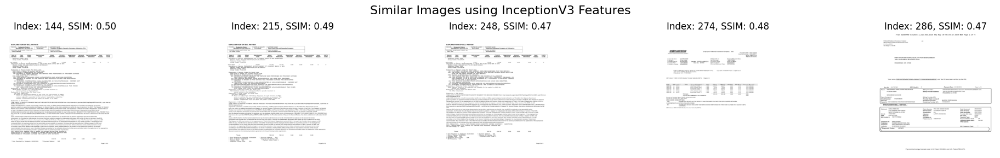

In [ ]:

# Set the threshold for similarity score
threshold = 0.47

# Find top similar images above the threshold using InceptionV3 features
inception_top_indices = [i for i, score in enumerate(inception_ssim_scores) if score >= threshold]

# Plot the similar images using InceptionV3 features
plt.figure(figsize=(20, 10))
plt.suptitle("Similar Images using InceptionV3 Features", fontsize=16)
for i, index in enumerate(inception_top_indices[:20]):
    plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns
    plt.imshow(all_images[index])
    plt.title(f'Index: {index}, SSIM: {inception_ssim_scores[index]:.2f}')
    plt.axis('off')
plt.tight_layout()
plt.show()


array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
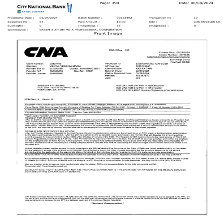

In [ ]:
all_images_resized[5]

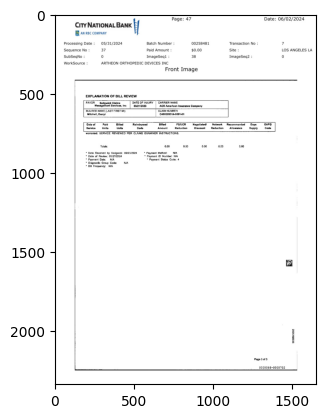

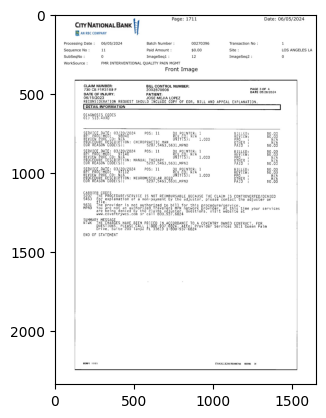

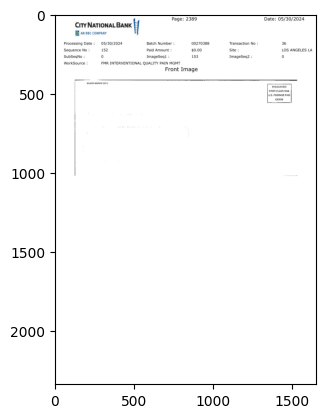

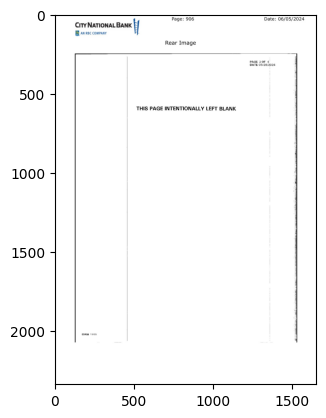

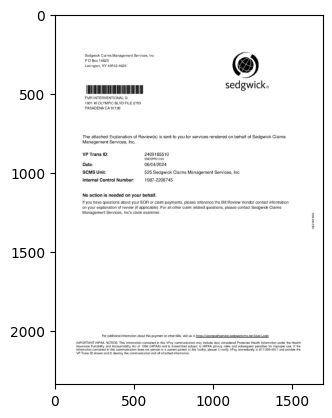

...

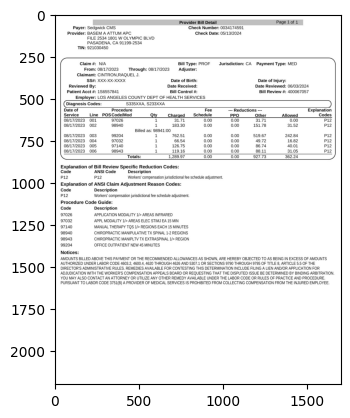

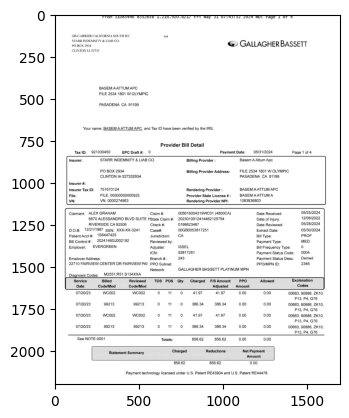

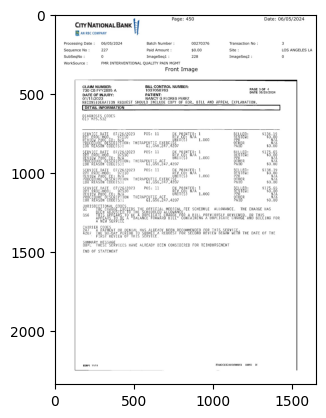

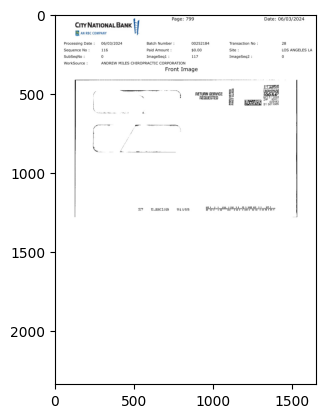

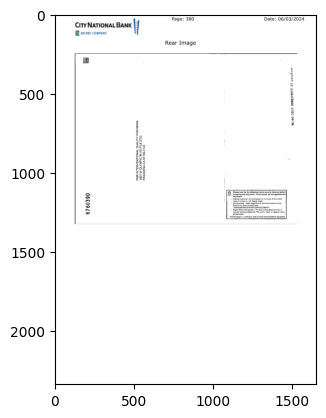

In [ ]:
# all_images_resized[62]
import matplotlib.pyplot as plt
for i in sample_images:
  # Load the image
  image = plt.imread("/content/drive/MyDrive/eob_Test/eob_test/images/"+i)

  # Show the image
  plt.imshow(image)
  plt.show()

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
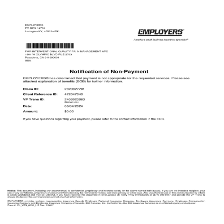

In [ ]:
all_images_resized[7]

In [ ]:
inception_top_indices = []
for i, score in enumerate(inception_ssim_scores):
    if score >= 0.5:
        inception_top_indices.append(i)

inception_top_indices, len(inception_ssim_scores)

([], 300)

In [ ]:
inception_ssim_scores

[0.18132948568579946,
 0.2722913124941151,
 0.2056709722410598,
 0.1578692398187323,
 0.2789166267267817,
 0.27877680295542995,
 0.1569515046026742,
 0.33208248712254834,
 0.20104916170494713,
 0.20475742263093763,
 0.24070899106116522,
 0.1809652487735798,
 0.288376233111878,
 0.24092927303009104,
 0.2719060479117566,
 0.24904928053377196,
 0.22285987413519684,
 0.2862335327479066,
 0.29225864711141303,
 0.2459913219087967,
 0.23139659115337938,
 0.12136555027758336,
 0.3013470942707756,
 0.20711654572920873,
 0.1968495367667202,
 0.27581956971042343,
 0.28934061399420535,
 0.2517921069491949,
 0.2815886838789057,
 0.1334746006264608,
 0.25086845505360683,
 0.25351942234393,
 0.1834700849768051,
 0.22531221683144764,
 0.2663122511114622,
 0.25385801634677946,
 0.25132786853871586,
 0.22241853551447943,
 0.13814005076589453,
 0.09341495474303711,
 0.2629703904712384,
 0.16306088226223656,
 0.27775610266020034,
 0.30729320739713123,
 0.20684087438689078,
 0.2594437055739358,
 0.30155771

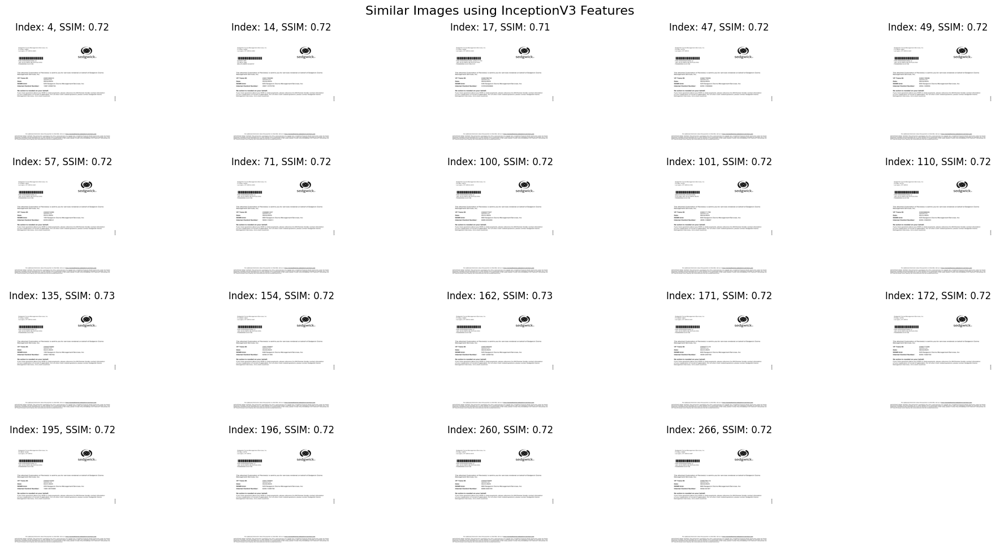

In [ ]:
# Set the threshold for similarity score
threshold = 0.71

# Find top similar images above the threshold using InceptionV3 features
inception_top_indices = [i for i, score in enumerate(inception_ssim_scores) if score >= threshold]

# Plot the similar images using InceptionV3 features
plt.figure(figsize=(20, 10))
plt.suptitle("Similar Images using InceptionV3 Features", fontsize=16)
for i, index in enumerate(inception_top_indices[:20]):
    plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns
    plt.imshow(all_images[index])
    plt.title(f'Index: {index}, SSIM: {inception_ssim_scores[index]:.2f}')
    plt.axis('off')
plt.tight_layout()
plt.show()


In [ ]:
plt.show()

In [ ]:
all_names[275]

'124411_Objection-to-Bill_EOB-Zero_06042024045432_MAILING_2024_06_04_13_04_21_1717488261-frgb441717488261_27_opt_0_image0.jpg'

In [ ]:
image = cv2.imread('/content/images/211694_Objection-to-Bill_EOB-Zero_06062024092327_MAILING_2024_06_05_15_49_21_1717584561-5kkY981717584561_21_opt_0_image0.jpg') #+ all_names[275])


# Convert the image from BGR (OpenCV format) to RGB (Matplotlib format)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 8))
# Display the image using Matplotlib
plt.imshow(image_rgb)
plt.axis('off')  # Hide the axis
plt.show()

NameError: name 'cv2' is not defined

In [ ]:
4 pm thursday

In [ ]:
import cv2
import numpy as np
from skimage import metrics
import matplotlib.pyplot as plt
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input as inception_preprocess_input

# Load the new image
new_img = cv2.imread('/content/drive/MyDrive/eob_Test/eob_test/images/'+sample_images[9])

# Resize the new image to a fixed size (e.g., 224x224) to ensure consistency
new_img_resized = cv2.resize(new_img, (224, 224))

# Load and resize all images in your dataset similarly
# Assuming 'all_images' contains the images dataset
all_images = np.array(all_images)
all_images_resized = [cv2.resize(img, (224, 224)) for img in all_images]

# Convert images to numpy arrays
new_image_np = np.array(new_img_resized)
all_images_np = np.array(all_images_resized)

# Preprocess images for InceptionV3
new_image_inception = inception_preprocess_input(new_image_np)
all_images_inception = inception_preprocess_input(all_images_np)

# Load pre-trained InceptionV3 model
inception_model = InceptionV3(weights='imagenet', include_top=False, pooling='max')

# Extract InceptionV3 features
new_features_inception = inception_model.predict(np.expand_dims(new_image_inception, axis=0))
all_features_inception = inception_model.predict(all_images_inception)

# Compute cosine similarity between the new image and images in your dataset using InceptionV3 features
inception_ssim_scores = [metrics.structural_similarity(new_features_inception.flatten(), features_inception.flatten())
                         for features_inception in all_features_inception]

# Set the threshold for similarity score
threshold = 0.6

# Find top similar images above the threshold using InceptionV3 features
inception_top_indices = [i for i, score in enumerate(inception_ssim_scores) if score >= threshold]

# Plot the similar images using InceptionV3 features
plt.figure(figsize=(20, 10))
plt.suptitle("Similar Images using InceptionV3 Features", fontsize=16)
for i, index in enumerate(inception_top_indices[:20]):
    plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns
    plt.imshow(all_images[index])
    plt.title(f'Index: {index}, SSIM: {inception_ssim_scores[index]:.2f}')
    plt.axis('off')
plt.tight_layout()
plt.show()


1/1 [==============================] - 2s 2s/step


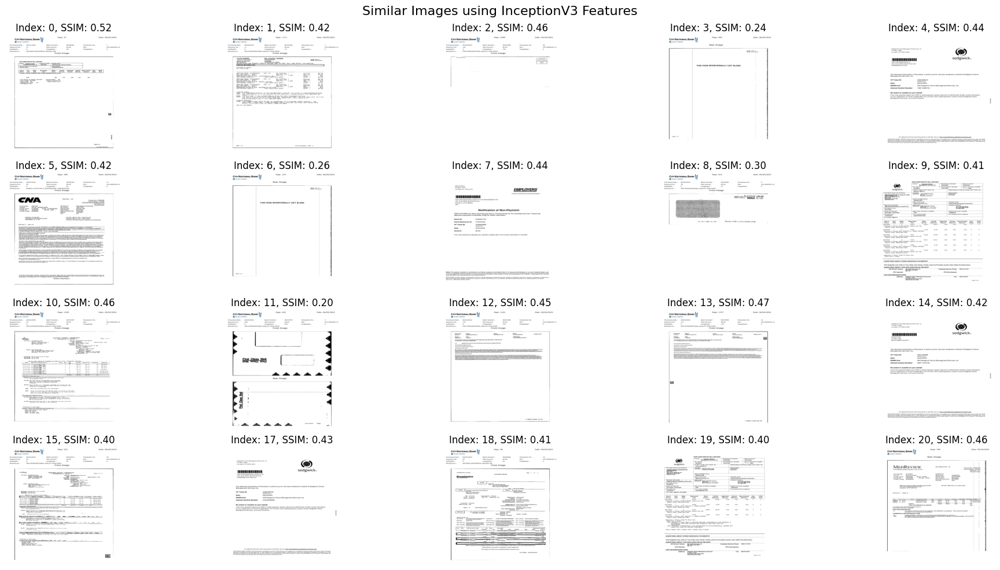

In [ ]:
# Set the threshold for similarity score
threshold = 0.2

# Find top similar images above the threshold using InceptionV3 features
inception_top_indices = [i for i, score in enumerate(inception_ssim_scores) if score >= threshold]

# Plot the similar images using InceptionV3 features
plt.figure(figsize=(20, 10))
plt.suptitle("Similar Images using InceptionV3 Features", fontsize=16)
for i, index in enumerate(inception_top_indices[:20]):
    plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns
    plt.imshow(all_images[index])
    plt.title(f'Index: {index}, SSIM: {inception_ssim_scores[index]:.2f}')
    plt.axis('off')
plt.tight_layout()
plt.show()

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
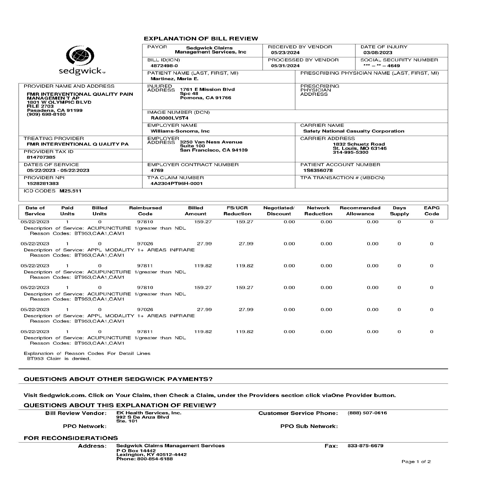

In [ ]:
#doing good on idx: 101, 3,
all_images[9]

In [ ]:
inception_top_indices # get the top indices and then save it and remove from all images

[4,
 7,
 14,
 17,
 47,
 49,
 57,
 71,
 85,
 89,
 97,
 100,
 101,
 110,
 135,
 154,
 162,
 171,
 172,
 190,
 195,
 196,
 260,
 266,
 286]

In [ ]:
# i = 0
# groups_dict = {}

In [ ]:
i=i+1
key = f"group{i}"  # Generate dynamic key like 'group1', 'group2', etc.
groups_dict[key] = inception_top_indices


3

In [ ]:
groups_dict, i

({'group1': [3, 6, 64],
  'group20': [4,
   7,
   14,
   17,
   47,
   49,
   57,
   71,
   85,
   89,
   97,
   100,
   101,
   110,
   135,
   154,
   162,
   171,
   172,
   190,
   195,
   196,
   260,
   266,
   286]},
 1)

In [ ]:

# Create a copy of all_images
copy_all_images = all_images.copy()

# Remove images corresponding to indices_to_remove from copy_all_images
copy_all_images = [image for idx, image in enumerate(all_images) if idx not in inception_top_indices]


# Print the original and modified lists to verify
print("Original all_images:", len(all_images))

print("\nCopy all_images after removal:", len(copy_all_images))
# rqandomly choose an image from copy_all_images and then inference on all images ..
# (modify this so that inference is lower, meaning instead of saving image idx same the image )

Original all_images: 300

Copy all_images after removal: 275


Number of images in group: 30
Number of remaining images: 0


In [ ]:
# Group similar images and remove them from the dataset
grouped_images, remaining_images = group_and_remove_similar_images(all_images, inception_ssim_scores, threshold=0.6)

print(f"Number of images in group: {len(grouped_images)}")
print(f"Number of remaining images: {len(remaining_images)}")

Exception ignored in: <function _xla_gc_callback at 0x7cceccc191b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 98, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 
Exception ignored in: <function _xla_gc_callback at 0x7cceccc191b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 98, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


Number of images in group: 30
Number of remaining images: 0


In [ ]:
for i in range(30):
  print(np.array(grouped_images[i]).shape, i)

(26, 500, 500, 3) 0
(25, 500, 500, 3) 1
(23, 500, 500, 3) 2
(23, 500, 500, 3) 3
(23, 500, 500, 3) 4
(20, 500, 500, 3) 5
(17, 500, 500, 3) 6
(16, 500, 500, 3) 7
(15, 500, 500, 3) 8
(15, 500, 500, 3) 9
(11, 500, 500, 3) 10
(9, 500, 500, 3) 11
(9, 500, 500, 3) 12
(8, 500, 500, 3) 13
(8, 500, 500, 3) 14
(7, 500, 500, 3) 15
(5, 500, 500, 3) 16
(5, 500, 500, 3) 17
(5, 500, 500, 3) 18
(5, 500, 500, 3) 19
(5, 500, 500, 3) 20
(5, 500, 500, 3) 21
(3, 500, 500, 3) 22
(3, 500, 500, 3) 23
(3, 500, 500, 3) 24
(2, 500, 500, 3) 25
(1, 500, 500, 3) 26
(1, 500, 500, 3) 27
(1, 500, 500, 3) 28
(1, 500, 500, 3) 29


array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
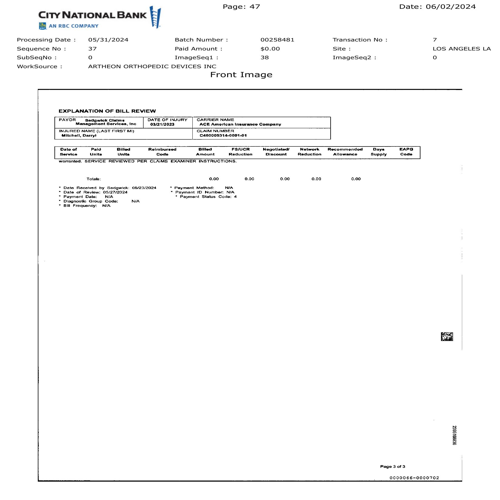

In [ ]:
all_images[0]

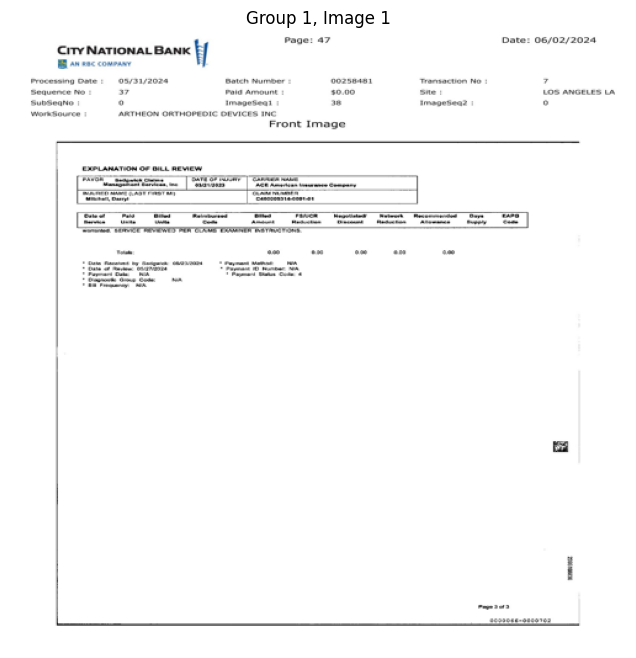

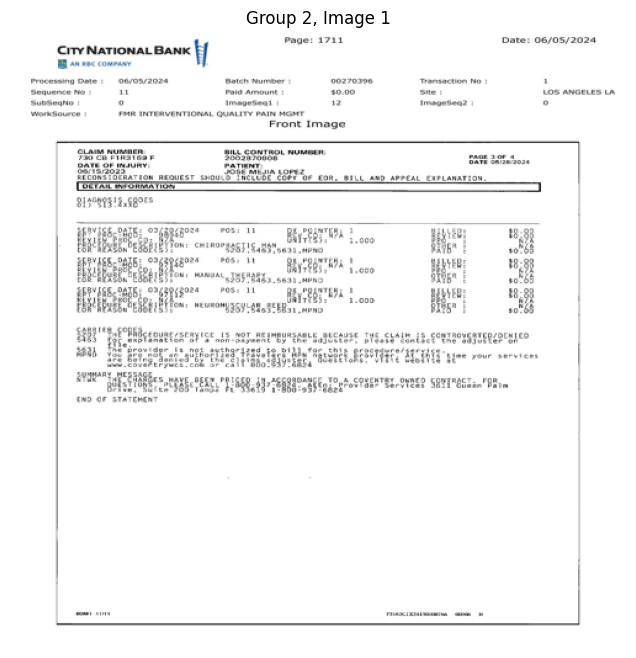

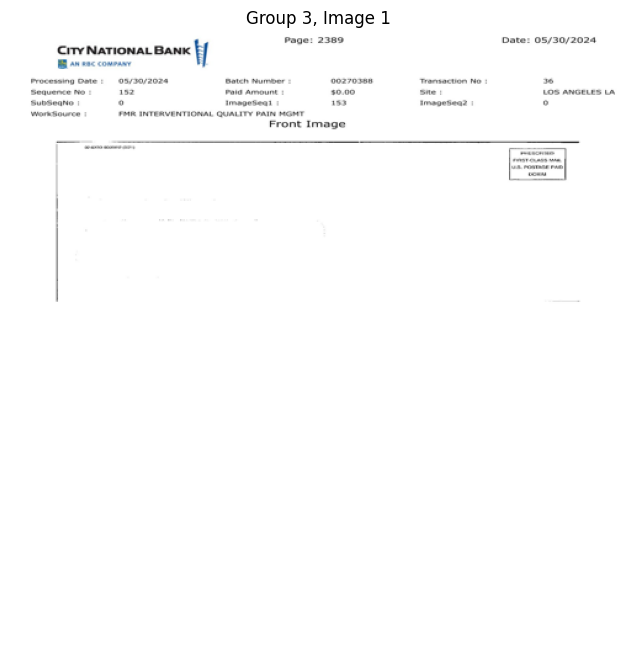

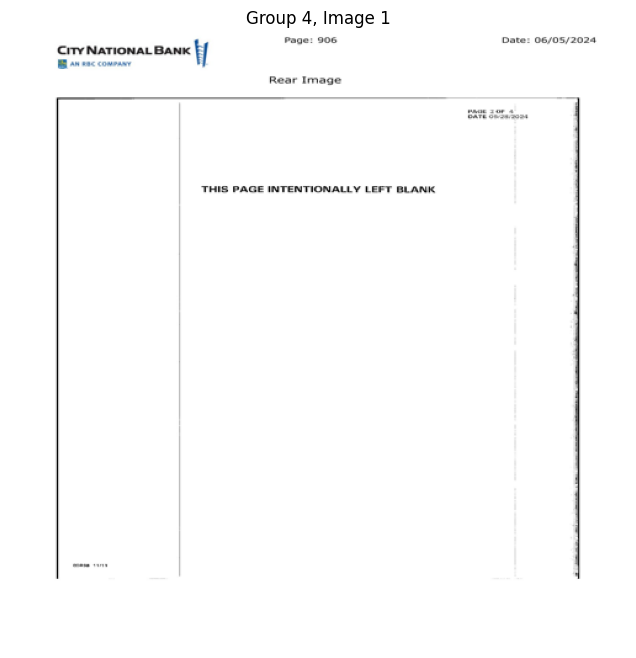

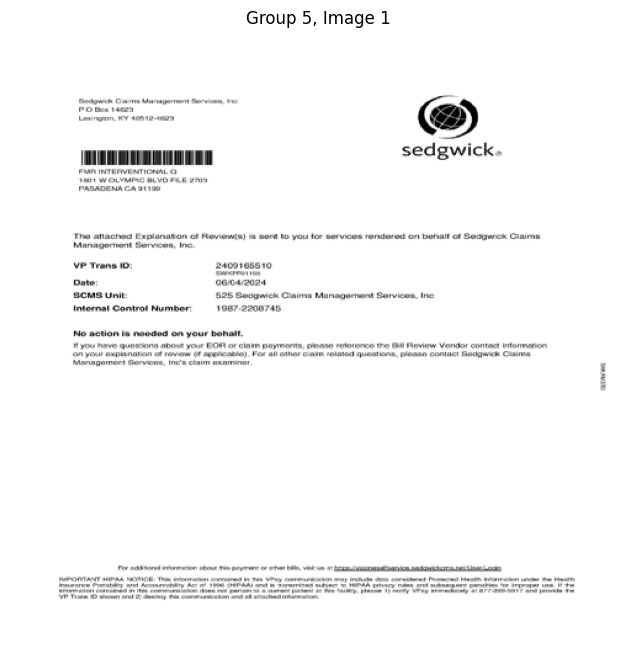

In [ ]:
def plot_image_groups(grouped_images, num_groups=5, image_index=0):
    """
    Plots groups of similar images.

    Parameters:
    - grouped_images: List of groups of similar images.
    - num_groups: Number of groups to display (default is 5).
    - image_index: Index of the image to display from each group (default is 0, the first image).
    """
    num_groups = min(num_groups, len(grouped_images))  # Ensure we don't exceed the number of groups available

    for group_index in range(num_groups):
        group = grouped_images[group_index]

        if image_index >= len(group):
            print(f"Warning: Group {group_index + 1} does not have {image_index + 1} images.")
            continue

        img = group[image_index]


        img = np.array(img)


        # Ensure correct dimensionality and type
        if img.ndim == 2:
            img = np.stack([img, img, img], axis=-1)  # Convert grayscale to RGB
        elif img.ndim == 3 and img.shape[2] == 1:
            img = np.concatenate([img, img, img], axis=-1)  # Convert grayscale to RGB

        # Convert to uint8 if necessary
        if img.dtype != np.uint8:
            img = img.astype(np.uint8)

        # Display the image
        plt.figure(figsize=(8, 8))
        plt.imshow(img)
        plt.title(f'Group {group_index + 1}, Image {image_index + 1}')
        plt.axis('off')
        plt.show()

# Example usage:
# Assuming grouped_images is already populated with groups of images
# grouped_images, remaining_images = group_and_remove_similar_images(all_images_np, inception_ssim_scores, threshold=0.6)
# print(f"Number of groups formed: {len(grouped_images)}")

# Call the function to plot the first image from each group
plot_image_groups(grouped_images, num_groups=5, image_index=0)
